Мои заметки:
- Нужно реализовать старт дрона недалеко от цели что бы моедель тренировалась
- Создать новую сессию chat gpt, попросить обьяснить и прокоментировать каждую строчку
- Использовать предтренированые CNN RESNET
---
- 1. Проблема в том что нету никакого логировния, так что я не понимаю прогресса обучения.
Сделал: реализовал подробное логирование, и визуализацию.
2. Проблема - дрон в обучение работает прекрассно, дрон на тестах начинает дергатся как только видит цель. Возможная проблема в том что обучение проходит на 4 картах, и сеть просто запоминает их.


# **0**. Установка зависимостей и базовые импорты



In [3]:
# ШАГ 0. УСТАНОВКА И ИМПОРТЫ

# (Если вы уже устанавливали эти библиотеки ранее в вашей среде Colab, то повторная установка не обязательна)
!pip install stable-baselines3[extra] gym imageio opencv-python shimmy>=2.0

import cv2
import math
import random
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
from collections import deque
from gym.wrappers import TimeLimit



# Импортируем модули из stable_baselines3
from stable_baselines3 import PPO
from stable_baselines3.common.vec_env import DummyVecEnv, SubprocVecEnv
from stable_baselines3.common.env_checker import check_env
from stable_baselines3.common.callbacks import EvalCallback, CheckpointCallback
from stable_baselines3.common.torch_layers import BaseFeaturesExtractor
from stable_baselines3.common.callbacks import BaseCallback
from stable_baselines3.common.vec_env import VecMonitor


import imageio
from IPython.display import Image, display

# Включаем inline-режим графиков
%matplotlib inline

# Проверяем, доступен ли GPU:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Используемое устройство:", device)


Используемое устройство: cuda


In [39]:
# Установка TensorBoard (если ещё не установлено)
%pip install tensorboard

import tensorflow as tf
import tensorboard
from google.colab import output

# Запуск TensorBoard и указание пути к логам
%load_ext tensorboard
%tensorboard --logdir ./ppo_drone_tensorboard/


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 13223), started 0:04:36 ago. (Use '!kill 13223' to kill it.)

<IPython.core.display.Javascript object>

#1. Утилиты для загрузки/обработки изображений



In [5]:
# ШАГ 1. УТИЛИТЫ ДЛЯ ГЕНЕРАЦИИ/ЗАГРУЗКИ КАРТ

def load_img(image_url):
    """
    Скачивает изображение по заданному URL и загружает его как BGR-массив.
    """
    import urllib.request
    urllib.request.urlretrieve(image_url, 'temp_map.jpg')
    big_map = cv2.imread('temp_map.jpg')
    if big_map is None:
        raise ValueError("Не удалось загрузить изображение! Проверьте URL.")
    print("Загруженное изображение:", big_map.shape)
    return big_map

def crop_random(img, crop_size=(256, 256)):
    """
    Случайно обрезает изображение 'img' (BGR) до 'crop_size' = (ширина, высота).
    """
    height, width, _ = img.shape
    crop_w, crop_h = crop_size
    if width < crop_w or height < crop_h:
        raise ValueError("Размер изображения меньше, чем crop_size.")
    start_x = random.randint(0, width - crop_w)
    start_y = random.randint(0, height - crop_h)
    cropped = img[start_y:start_y + crop_h, start_x:start_x + crop_w].copy()
    return cropped

def generate_random_map(height=256, width=256, img=None):
    """
    Генерирует карту высотой 'height', шириной 'width'.
    Если 'img' не None, берёт случайный фрагмент из img.
    Если None, создаёт шум.
    """
    if img is not None:
        # Берём случайный вырез из картинки
        return crop_random(img, (width, height))
    else:
        # Генерируем шум
        gen_map = np.random.randint(0, 256, (height, width, 3), dtype=np.uint8)
        return gen_map

def get_random_target_crop(big_map, target_size=32):
    """
    Случайным образом выбирает квадрат target_size x target_size из big_map.
    Возвращает сам вырез (target_crop) и координаты (x,y) левого верхнего угла.
    """
    H, W, _ = big_map.shape
    if H < target_size or W < target_size:
        raise ValueError("Карта меньше, чем target_size.")
    y = random.randint(0, H - target_size)
    x = random.randint(0, W - target_size)
    target_crop = big_map[y:y+target_size, x:x+target_size, :]
    return target_crop, x, y


/usr/local/lib/python3.11/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# 2. Создадим класс среды DroneEnv с учётом двух отдельных «картинок»
Чтобы PPO мог получать (env_view, goal_view), мы должны как-то передавать это в reset и step. Но в gym всё же один выход — observation. Поэтому мы сделаем, что observation = (env_view, goal_view) в одном тензоре, но «разделённом» по batch-каналу следующим образом:

env_view.shape = (3, 64, 64)
goal_view.shape = (3, 64, 64)
Мы можем склеить их по оси batch → (6, 64, 64) (но аккуратно, потому что теперь мы понимаем, что первые 3 канала — env, а вторые 3 канала — goal).
Однако для нашей double-stream политики мы создадим пользовательский FeaturesExtractor, который будет знать, что (6, 64, 64) = (env_view, goal_view).

python
Копировать


In [42]:
# ШАГ 2. ОПРЕДЕЛЯЕМ СРЕДУ DRONEENV

import gym

class DroneEnv(gym.Env):
    """
    Среда, где дрон ищет фрагмент (target_crop) на большой карте (big_map).
    Дрон видит 64x64 (env_view), а также изображение цели (goal_view) 64x64.
    На выходе observation = (6, 64, 64).

    Добавлено: при done=True записываем info["is_success"] = True/False,
    чтобы извне знать, удалось ли достичь цели.
    """
    def __init__(self,
                 big_map,             # (H,W,3)
                 target_crop,         # (target_size, target_size,3)
                 target_x, target_y,  # координаты цели (для расчёта дистанции)
                 drone_view_size=64,
                 target_size=32,
                 target_threshold=5,
                 render_mode=None):
        super(DroneEnv, self).__init__()
        self.render_mode = render_mode
        self.big_map = big_map
        self.height, self.width, _ = big_map.shape
        self.target_crop = target_crop
        self.target_size = target_size
        self.target_x = target_x
        self.target_y = target_y

        self.drone_view_size = drone_view_size
        self.target_threshold = target_threshold

        # Действия: 4 дискретных: 0=up, 1=down, 2=left, 3=right
        self.action_space = gym.spaces.Discrete(4)

        # Наблюдение: (6,64,64)
        # - каналы [0..2] -> текущий env_view (RGB)
        # - каналы [3..5] -> цель (goal_view, тоже RGB)
        self.observation_space = gym.spaces.Box(
            low=0.0, high=1.0, shape=(6, self.drone_view_size, self.drone_view_size), dtype=np.float32
        )

        self.history_of_step_que = deque(maxlen=20)
        self.reset()

    def reset(self):
        # Случайная позиция дрона
        self.drone_x = random.randint(0, self.width - 1)
        self.drone_y = random.randint(0, self.height - 1)
        self.prev_distance = self._distance_to_target(self.drone_x, self.drone_y)

        self.history_of_step_que.clear()
        return self._get_observation()

    def step(self, action):
        # По умолчанию is_success=False (пока не докажем обратное)
        info = {"is_success": False}

        # Применяем действие
        if action == 0:   # up
            self.drone_y -= 1
        elif action == 1: # down
            self.drone_y += 1
        elif action == 2: # left
            self.drone_x -= 1
        elif action == 3: # right
            self.drone_x += 1

        done = False
        out_of_bounds = (
            self.drone_x < 0 or self.drone_x >= self.width or
            self.drone_y < 0 or self.drone_y >= self.height
        )

        if out_of_bounds:
            # Вышли за границы - эпизод завершается неудачно
            reward = -5.0
            done = True
            info["is_success"] = False
        else:
            # Рассчитываем дистанцию до цели
            new_distance = self._distance_to_target(self.drone_x, self.drone_y)
            # Награда за приближение (разница между предыдущей и текущей дистанцией)
            reward = (self.prev_distance - new_distance)

            # Небольшой штраф за каждый шаг, чтобы дрон не петлял зря
            reward += -0.01

            # Если мы достаточно близко к цели (<= target_threshold)
            if new_distance <= self.target_threshold:
                reward += 20.0
                done = True
                info["is_success"] = True
            else:
                info["is_success"] = False

            # Наказание за топтание на месте (дрон был в этих координатах недавно)
            if (self.drone_x, self.drone_y) in self.history_of_step_que:
                reward -= 0.4

            self.history_of_step_que.append((self.drone_x, self.drone_y))
            self.prev_distance = new_distance

        observation = self._get_observation()
        return observation, reward, done, info

    def _distance_to_target(self, x, y):
        # Центр цели
        cx = self.target_x + self.target_size // 2
        cy = self.target_y + self.target_size // 2
        return math.sqrt((x - cx)**2 + (y - cy)**2)

    def _get_observation(self):
        """
        Возвращаем (6,64,64), где:
          1..3 каналы: локальный фрагмент (env_view)
          4..6 каналы: goal_view (растянутый target_crop)
        """
        env_view = self._crop_around_drone()
        goal_view = cv2.resize(self.target_crop,
                               (self.drone_view_size, self.drone_view_size),
                               interpolation=cv2.INTER_AREA)

        # BGR->RGB
        env_rgb = cv2.cvtColor(env_view, cv2.COLOR_BGR2RGB)
        goal_rgb = cv2.cvtColor(goal_view, cv2.COLOR_BGR2RGB)

        # Нормируем [0..1]
        env_rgb = env_rgb.astype(np.float32) / 255.0
        goal_rgb = goal_rgb.astype(np.float32) / 255.0

        # Транспонируем (H,W,C)->(C,H,W)
        env_rgb = np.transpose(env_rgb, (2,0,1))
        goal_rgb = np.transpose(goal_rgb, (2,0,1))

        # Склеиваем по каналам
        obs = np.concatenate([env_rgb, goal_rgb], axis=0)  # (6,64,64)
        return obs

    def _crop_around_drone(self):
        half = self.drone_view_size // 2
        left = max(0, self.drone_x - half)
        right = min(self.width, self.drone_x + half)
        top = max(0, self.drone_y - half)
        bottom = min(self.height, self.drone_y + half)
        crop = self.big_map[top:bottom, left:right, :]
        h, w, c = crop.shape
        result = np.zeros((self.drone_view_size, self.drone_view_size, 3), dtype=np.uint8)
        result[:h, :w, :] = crop
        return result


    def render(self, mode="rgb_array"):
      """
      Возвращает numpy-массив (RGB), пригодный для сохранения в видео/GIF.

      Добавлено: рисуем рамку вокруг droneView размером self.drone_view_size x self.drone_view_size.
      """
      # Копируем карту (BGR)
      frame_bgr = self.big_map.copy()

      # Рисуем прямоугольник цели (синий)
      cv2.rectangle(
          frame_bgr,
          (self.target_x, self.target_y),
          (self.target_x + self.target_size, self.target_y + self.target_size),
          color=(255, 0, 0),
          thickness=2
      )

      # Рисуем позицию дрона (красный кружок)
      cv2.circle(
          frame_bgr,
          (self.drone_x, self.drone_y),
          radius=5,
          color=(0, 0, 255),
          thickness=-1
      )

      # Рисуем пройденные координаты (зелёные точки)
      for (px, py) in self.history_of_step_que:
          cv2.circle(frame_bgr, (px, py), 2, (0, 255, 0), -1)

      # === Добавляем рамку droneView ===
      half = self.drone_view_size // 2
      top_left_x = max(0, self.drone_x - half)
      top_left_y = max(0, self.drone_y - half)
      bottom_right_x = min(self.width - 1, self.drone_x + half)
      bottom_right_y = min(self.height - 1, self.drone_y + half)

      cv2.rectangle(
          frame_bgr,
          (top_left_x, top_left_y),
          (bottom_right_x, bottom_right_y),
          color=(0, 255, 255),  # желтовато-зелёный цвет
          thickness=2
      )

      # BGR -> RGB
      frame_rgb = cv2.cvtColor(frame_bgr, cv2.COLOR_BGR2RGB)
      return frame_rgb

# 3. Реализация кастомного DualStream-FeatureExtractor
В stable-baselines3 (SB3) мы можем переопределить BaseFeaturesExtractor, чтобы разрезать (6,64,64) на (3,64,64) и (3,64,64), прогнать каждое через свою CNN, а потом склеить результаты.

In [7]:
# ШАГ 3. DUAL-STREAM EXTRACTOR

class DualStreamExtractor(BaseFeaturesExtractor):
    """
    Класс, который обрабатывает observation=(6,64,64):
      - env_view = (3,64,64)
      - goal_view = (3,64,64)

    Затем две CNN ветви для каждого из них, и склейка векторов.
    """

    def __init__(self, observation_space: gym.spaces.Box, features_dim: int = 256):
        # super().__init__ - обязательно
        super(DualStreamExtractor, self).__init__(observation_space, features_dim)

        # Убедимся, что вход (6,64,64)
        assert observation_space.shape[0] == 6, "Ожидается 6 каналов (env + goal)."
        self.height = observation_space.shape[1]
        self.width = observation_space.shape[2]

        # Первая ветвь (для env)
        self.cnn_env = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=8, stride=4),
            nn.ReLU(),
            nn.Conv2d(32, 64, kernel_size=4, stride=2),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, stride=1),
            nn.ReLU(),
            nn.Flatten()
        )

        # Вторая ветвь (для goal)
        self.cnn_goal = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=8, stride=4),
            nn.ReLU(),
            nn.Conv2d(32, 64, kernel_size=4, stride=2),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, stride=1),
            nn.ReLU(),
            nn.Flatten()
        )

        # Вычислим выходные размерности
        with torch.no_grad():
            dummy_input = torch.zeros(1, 3, self.height, self.width)
            env_out = self.cnn_env(dummy_input)
            goal_out = self.cnn_goal(dummy_input)
            self.env_out_dim = env_out.shape[1]
            self.goal_out_dim = goal_out.shape[1]

        # Итоговая fc-голова
        self.fc = nn.Sequential(
            nn.Linear(self.env_out_dim + self.goal_out_dim, 512),
            nn.ReLU(),
            nn.Linear(512, features_dim),
            nn.ReLU()
        )
        # Запоминаем общий размер фичей
        self._features_dim = features_dim

    def forward(self, obs: torch.Tensor) -> torch.Tensor:
        """
        obs.shape = (batch, 6, 64, 64)
        Разделяем на (env: [:,0:3]) и (goal: [:,3:6]).
        """
        env_view = obs[:, 0:3, :, :]
        goal_view = obs[:, 3:6, :, :]

        env_out = self.cnn_env(env_view)
        goal_out = self.cnn_goal(goal_view)

        combined = torch.cat([env_out, goal_out], dim=1)
        features = self.fc(combined)
        return features


# Шаг 4. Создание векторизованных сред (для ускорения) и запуск PPO

In [41]:
# ШАГ 4. ФУНКЦИИ ДЛЯ СОЗДАНИЯ СРЕДЫ

def make_drone_env(global_img=None,
                   global_map_height=100,
                   global_map_width=100,
                   global_target_size=50):
    """
    Генерирует big_map + target_crop, создаёт DroneEnv.
    """
    # Генерируем карту (случайную или вырез из global_img)
    big_map = generate_random_map(height=global_map_height,
                                  width=global_map_width,
                                  img=global_img)
    # Рандомно вырезаем цель
    target_crop, tx, ty = get_random_target_crop(big_map, target_size=global_target_size)
    env = DroneEnv(big_map, target_crop, tx, ty,
                   drone_view_size=64,
                   target_size=global_target_size,
                   target_threshold=5,
                   render_mode="rgb_array")
    env = TimeLimit(env, max_episode_steps=200) #max step!!!+===============

    TimeLimit(env, max_episode_steps=200)
    return env

def make_vec_envs(num_envs=4, global_img=None):
    """
    Создаёт num_envs штук DroneEnv, оборачивает их в SubprocVecEnv.
    """
    def _make_env():
        def _init():
            return make_drone_env(global_img)
        return _init

    env_fns = [_make_env() for _ in range(num_envs)]
    #vec_env = SubprocVecEnv(env_fns)
    vec_env = DummyVecEnv(env_fns)
    return vec_env


#### Custom collback for loging:

In [20]:
def safe_mean(arr):
    return np.mean(arr) if len(arr) > 0 else 0.0

class ProgressCallback(BaseCallback):
    """
    Кастомный колбэк, который после каждого rollout:
      1) Считает средние показатели (reward, длину эпизода).
      2) Считает процент успешных эпизодов (успех ~ reward >= 5, или info["is_success"]).
      3) Логирует всю эту информацию в TensorBoard.
      4) Выводит то же самое в консоль.
    """
    def __init__(self, verbose=1):
        super(ProgressCallback, self).__init__(verbose)

    def _on_training_start(self) -> None:
        """Вызывается один раз при запуске model.learn()"""
        self.n_rollout = 0

    def _on_step(self) -> bool:
        """Метод обязателен для наследников BaseCallback"""
        return True

    def _on_rollout_end(self) -> None:
        """
        Вызывается в конце каждого роллаута (когда собрано n_steps*num_envs шагов).
        Здесь мы:
         - смотрим ep_info_buffer (последние завершённые эпизоды),
         - подсчитываем метрики,
         - логируем в консоль и в TensorBoard.
        """
        self.n_rollout += 1

        # Общее количество шагов (timesteps) с начала обучения
        total_timesteps = self.model.num_timesteps

        # Массивы наград и длин эпизодов
        episode_rewards = [ep_info["r"] for ep_info in self.model.ep_info_buffer]
        episode_lengths = [ep_info["l"] for ep_info in self.model.ep_info_buffer]
        n_episodes = len(episode_rewards)

        avg_reward = safe_mean(episode_rewards)
        avg_length = safe_mean(episode_lengths)

        # Подсчитаем успешные эпизоды
        # Пример эвристики: reward >= 5 => "успех"
        success_count = sum(1 for r in episode_rewards if r >= 5.0)
        success_rate = success_count / n_episodes if n_episodes > 0 else 0.0

        # Читаем потери, записанные PPO на предыдущем тренинге
        log_dict = self.logger.name_to_value
        total_loss = log_dict.get("train/loss", None)
        policy_loss = log_dict.get("train/policy_gradient_loss", None)
        value_loss = log_dict.get("train/value_loss", None)

        # Логируем всё в TensorBoard
        # (SB3 сам вызовет self.logger.dump() в нужное время)
        self.logger.record("rollout/mean_reward", float(avg_reward))
        self.logger.record("rollout/mean_length", float(avg_length))
        self.logger.record("rollout/success_rate", float(success_rate))

        if total_loss is not None:
            self.logger.record("rollout/total_loss", float(total_loss))
        if policy_loss is not None:
            self.logger.record("rollout/policy_loss", float(policy_loss))
        if value_loss is not None:
            self.logger.record("rollout/value_loss", float(value_loss))

        # Вывод в консоль
        if self.verbose > 0:
            msg_loss  = f"loss={total_loss:.4f}" if total_loss is not None else "loss=N/A"
            msg_pol   = f"policy_loss={policy_loss:.4f}" if policy_loss is not None else "policy_loss=N/A"
            msg_val   = f"value_loss={value_loss:.4f}"   if value_loss is not None else "value_loss=N/A"

            print(f"[Rollout #{self.n_rollout}] timesteps={total_timesteps}, "
                  f"episodes={n_episodes}, avg_reward={avg_reward:.2f}, success_rate={success_rate:.2%}, "
                  f"avg_length={avg_length:.1f}, {msg_loss}, {msg_pol}, {msg_val}")


### колбэк для сохранения GIF: TrajectoryVideoCallback

In [46]:
import imageio
from stable_baselines3.common.callbacks import BaseCallback

class TrajectoryVideoCallback(BaseCallback):
    """
    Сохраняет анимацию (GIF) движения дрона за каждый роллаут (update).
    Будьте осторожны: при большом кол-ве итераций это может быть очень объёмно!

    Параметры:
    - every_n_rollouts: как часто сохранять видео (каждые N роллаутов).
    - fps: частота кадров для GIF.
    - verbose: 0 или 1, контроль печати в консоль.
    """
    def __init__(self, every_n_rollouts=1, gif_prefix="trajectory", fps=10, verbose=0):
        super().__init__(verbose=verbose)
        self.every_n_rollouts = every_n_rollouts
        self.gif_prefix = gif_prefix
        self.fps = fps
        self.frames = []

    def _init_callback(self) -> None:
        """Вызывается один раз при начале обучения (model.learn)."""
        self.rollout_count = 0
        if self.verbose > 0:
            print("TrajectoryVideoCallback initialized.")

    def _on_rollout_start(self) -> None:
        """
        Вызывается в начале каждого роллаута (когда PPO начинает собирать новый батч).
        Очищаем список кадров.
        """
        self.frames = []

    def _on_step(self) -> bool:
        """
        Вызывается на каждом шаге среды.
        Получаем кадр из env.render() и добавляем в список.
        """
        # Если у нас векторизованная среда с num_envs>1, то self.training_env.render()
        # может быть неоднозначным. Обычно лучше делать render() из env.envs[0] или т.п.
        # Для простоты возьмем первый.
        # Или, если num_envs=1, то просто self.training_env.render()
        frame = self.training_env.envs[0].render()
        # Если render не реализован, frame будет None, нужно проверять:
        if frame is not None:
            self.frames.append(frame)

        return True  # Продолжаем обучение

    def _on_rollout_end(self) -> None:
        """
        Вызывается, когда PPO собрал n_steps * num_envs шагов.
        Сохраним GIF, если это "наш" роллаут (каждый every_n_rollouts).
        """
        self.rollout_count += 1
        if self.rollout_count % self.every_n_rollouts == 0 and len(self.frames) > 0:
            gif_filename = f"ppo_drone_tensorboard/PPO_12/{self.gif_prefix}_rollout_{self.rollout_count}.gif"
            imageio.mimsave(gif_filename, self.frames, fps=self.fps)

            if self.verbose > 0:
                print(f"[TrajectoryVideoCallback] GIF saved: {gif_filename}")


### Start:

In [47]:
# СОЗДАЁМ СРЕДУ
num_envs = 4
env = VecMonitor(make_vec_envs(num_envs=num_envs, global_img=None))  # None -> генерируем шумные карты

check_env(env.envs[0])  # Проверим одну среду на корректность

# Задаём policy_kwargs, указывая DualStreamExtractor
policy_kwargs = dict(
    features_extractor_class=DualStreamExtractor,
    features_extractor_kwargs=dict(features_dim=256),  # Размер выходных фич
)

# ИНИЦИАЛИЗАЦИЯ МОДЕЛИ PPO
model = PPO(
    "CnnPolicy",
    env,
    policy_kwargs=policy_kwargs,
    verbose=1,
    learning_rate=2.5e-4,
    n_steps=512,       # Можно менять
    batch_size=256,
    n_epochs=15,         # Внутренние эпохи на каждый rollout
    gamma=0.99,
    gae_lambda=0.95,
    clip_range=0.2,
    ent_coef=0.0,
    vf_coef=0.5,
    max_grad_norm=0.5,
    tensorboard_log="./ppo_drone_tensorboard/",
    device=device,   # gpu/cpu
    use_sde=False
)

# Колбэки для сохранения:
# Настройка эвалюации ?
eval_env = make_vec_envs(num_envs=1, global_img=None)
eval_callback = EvalCallback(
    eval_env,
    best_model_save_path='./logs/best_model',
    log_path='./logs/results',
    eval_freq=4000,           # частота запуска процедуры оценки
    deterministic=True,
    render=False,
    verbose=0
)

checkpoint_callback = CheckpointCallback(
    save_freq=10000,
    save_path='./logs/',
    name_prefix='ppo_drone'
)
# - verbose - количество выводимой информации
logging_callback = ProgressCallback(verbose=1)


video_callback = TrajectoryVideoCallback(every_n_rollouts=2, verbose=1)

# ЗАПУСК ОБУЧЕНИЯ
model.learn(
    total_timesteps=150000,
    callback=[eval_callback, checkpoint_callback, logging_callback,video_callback],   #Object wich calls in procces of traning
    log_interval=10
)

# Сохраняем итоговую модель
model.save("ppo_drone_final")
print("Обучение завершено и модель сохранена!")


Using cuda device
Logging to ./ppo_drone_tensorboard/PPO_12
TrajectoryVideoCallback initialized.


/usr/local/lib/python3.11/dist-packages/stable_baselines3/common/callbacks.py:418: UserWarning: Training and eval env are not of the same type<stable_baselines3.common.vec_env.vec_monitor.VecMonitor object at 0x7c1dac1b8c90> != <stable_baselines3.common.vec_env.dummy_vec_env.DummyVecEnv object at 0x7c1db41b9b50>
  warnings.warn("Training and eval env are not of the same type" f"{self.training_env} != {self.eval_env}")


[Rollout #1] timesteps=2048, episodes=10, avg_reward=-40.67, success_rate=0.00%, avg_length=170.3, loss=N/A, policy_loss=N/A, value_loss=N/A
[Rollout #2] timesteps=4096, episodes=24, avg_reward=-35.40, success_rate=0.00%, avg_length=159.4, loss=0.6964, policy_loss=-0.0146, value_loss=2.4155
[TrajectoryVideoCallback] GIF saved: ppo_drone_tensorboard/PPO_12/trajectory_rollout_2.gif
[Rollout #3] timesteps=6144, episodes=41, avg_reward=-30.86, success_rate=4.88%, avg_length=143.3, loss=0.7065, policy_loss=-0.0155, value_loss=3.1496
[Rollout #4] timesteps=8192, episodes=52, avg_reward=-28.43, success_rate=9.62%, avg_length=150.1, loss=0.9471, policy_loss=-0.0072, value_loss=5.1609
[TrajectoryVideoCallback] GIF saved: ppo_drone_tensorboard/PPO_12/trajectory_rollout_4.gif
[Rollout #5] timesteps=10240, episodes=73, avg_reward=-26.30, success_rate=8.22%, avg_length=134.1, loss=1.4189, policy_loss=-0.0115, value_loss=6.9280
[Rollout #6] timesteps=12288, episodes=86, avg_reward=-25.49, success_ra

/usr/local/lib/python3.11/dist-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 44.4        |
|    mean_reward          | -39.7       |
|    success_rate         | 0           |
| rollout/                |             |
|    mean_length          | 133         |
|    mean_reward          | -24         |
|    policy_loss          | -0.011      |
|    success_rate         | 0.09        |
|    total_loss           | 0.955       |
|    value_loss           | 4.73        |
| time/                   |             |
|    total_timesteps      | 16000       |
| train/                  |             |
|    approx_kl            | 0.012103895 |
|    clip_fraction        | 0.0993      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.32       |
|    explained_variance   | 0.255       |
|    learning_rate        | 0.00025     |
|    loss                 | 0.951       |
|    n_updates            | 105         |
|    policy_gradient_loss | -0.007

# Шаг 5. Тестирование и визуализация результатов


In [58]:
def test_ppo(model, num_episodes=3, max_steps=200, global_img=None):
    """
    Запускаем модель на нескольких (num_episodes) тестовых эпизодах.
    Каждый эпизод:
      - генерируется новая карта и цель (make_drone_env),
      - собираются кадры методом env.render(),
      - сохраняется GIF.
    """
    for ep in range(1, num_episodes + 1):
        # Создаём заново среду; внутри make_drone_env
        # big_map и координаты цели будут случайными
        test_env = make_drone_env(global_img)  # или передайте другую картинку, если нужно

        obs = test_env.reset()
        frames = []
        total_reward = 0.0
        done = False
        steps = 0

        # Основной цикл эпизода
        while not done and steps < max_steps:
            # 1) Сохраняем текущий кадр (если render() вернёт None, проверим)
            frame = test_env.render()
            if frame is not None:
                frames.append(frame)

            # 2) Преобразуем obs к подходящему формату и запрашиваем действие
            obs_tensor = obs[None, :].astype(np.float32)
            action, _ = model.predict(obs_tensor, deterministic=True)

            # 3) Делаем шаг
            obs, reward, done, info = test_env.step(int(action))
            total_reward += reward
            steps += 1

        print(f"[Тест эпизод {ep}] Накопленная награда: {total_reward:.2f}, Шагов: {steps}")

        # Сохраняем анимацию в GIF
        gif_filename = f"drone_animation_episode_{ep}.gif"
        imageio.mimsave(gif_filename, frames, fps=10)
         # Отображаем GIF прямо в блокноте (Colab/Jupyter)
        with open(gif_filename, 'rb') as f:
            display(Image(data=f.read()))

<ipython-input-58-3fee45bce8dd>:32: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  obs, reward, done, info = test_env.step(int(action))


[Тест эпизод 1] Накопленная награда: -77.98, Шагов: 200


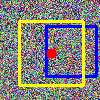

[Тест эпизод 2] Накопленная награда: -63.38, Шагов: 200


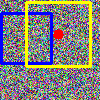

[Тест эпизод 3] Накопленная награда: -68.05, Шагов: 200


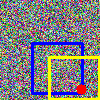

[Тест эпизод 4] Накопленная награда: -32.21, Шагов: 200


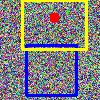

[Тест эпизод 5] Накопленная награда: -17.25, Шагов: 200


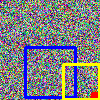

[Тест эпизод 6] Накопленная награда: -83.09, Шагов: 200


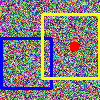

[Тест эпизод 7] Накопленная награда: -77.89, Шагов: 200


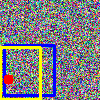

[Тест эпизод 8] Накопленная награда: -81.17, Шагов: 200


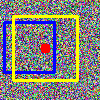

[Тест эпизод 9] Накопленная награда: -82.40, Шагов: 200


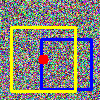

[Тест эпизод 10] Накопленная награда: -70.80, Шагов: 200


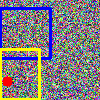

In [61]:
# Пример запуска теста (после обучения):
test_ppo(model, num_episodes=10, max_steps=200, global_img=None)